In [1]:
from runner import classify_facts

from tqdm.notebook import tqdm
import pandas as pd
import json
from transformers import AutoTokenizer, AutoModelForSequenceClassification, AutoModelForSeq2SeqLM
import matplotlib.pyplot as plt
import seaborn as sns
import os
from PIL import Image

def aggregate_nli(prediction):
    return prediction['entailment'] - prediction['contradiction']

def show_results(res):
    data = {}
    
    for k, v in res.items():
        *img, num = "".join(k.split('.')[0]).split("_")
        img = "_".join(img)
        if img not in data:
            data[img] = {}
        data[img][int(num)] = v

    df = pd.DataFrame(data)
    acc = (df.loc[0] < df.loc[1]).mean()
    print("Acc =", acc)
    return df, acc

data_path = "dataset"
device = "cuda"

label_to_id = {
    'entailment': 1,
    'neutral': 0,
    'contradiction': -1
}

visualise = False
all_res = []

In [6]:
for cap_model in ['llava', 'blip', 'gpt2', 'gpt4']:
    nli_res = []
    for nli_model in ['sileod/deberta-v3-base-tasksource-nli', 'MoritzLaurer/mDeBERTa-v3-base-xnli-multilingual-nli-2mil7']:
        res = {}
        tokenizer = AutoTokenizer.from_pretrained(nli_model)
        model = AutoModelForSequenceClassification.from_pretrained(nli_model).to(device)

        vnli = json.load(open(f'outputs_{cap_model}/vq2_scores.json', 'r'))
        img_paths = sorted(vnli.keys())

        for img_path in img_paths:
            scores = vnli[img_path]
            atomic_facts = list(scores.keys())

            classified_facts, metric, min_facts = classify_facts(atomic_facts, aggregate_nli, tokenizer, model, device)
            res[img_path] = metric

            if visualise:
                fig, axs = plt.subplots(ncols=2)
                fig.set_figwidth(15)
                img = Image.open(os.path.join('../dataset', img_path))
                imgplot = plt.imshow(img)
                sns.heatmap(classified_facts, annot=True, fmt=".2f", ax=axs[0])

        _, acc = show_results(res)
        nli_res.append(acc)
    all_res.append(nli_res)

Asking to truncate to max_length but no maximum length is provided and the model has no predefined maximum length. Default to no truncation.


Acc = 0.6842105263157895
Acc = 0.42105263157894735


Asking to truncate to max_length but no maximum length is provided and the model has no predefined maximum length. Default to no truncation.


Acc = 0.5263157894736842
Acc = 0.6842105263157895


Asking to truncate to max_length but no maximum length is provided and the model has no predefined maximum length. Default to no truncation.


Acc = 0.3684210526315789
Acc = 0.3157894736842105


Asking to truncate to max_length but no maximum length is provided and the model has no predefined maximum length. Default to no truncation.


Acc = 0.631578947368421
Acc = 0.6842105263157895


In [2]:
tokenizer = AutoTokenizer.from_pretrained("google/t5_xxl_true_nli_mixture")
model = AutoModelForSeq2SeqLM.from_pretrained("google/t5_xxl_true_nli_mixture", device_map="auto")

/home/petrushina/miniconda3/envs/llm/lib/python3.10/site-packages/transformers/utils/generic.py:311: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(
/home/petrushina/miniconda3/envs/llm/lib/python3.10/site-packages/transformers/utils/generic.py:311: UserWarning: torch.utils._pytree._register_pytree_node is deprecated. Please use torch.utils._pytree.register_pytree_node instead.
  torch.utils._pytree._register_pytree_node(


Loading checkpoint shards:   0%|          | 0/5 [00:00<?, ?it/s]

In [3]:
from scipy.special import softmax
import numpy as np

def get_t5_logprob(prompt, T=5):
    input_ids = tokenizer(prompt, return_tensors="pt").input_ids.to(device)
    outputs = model.generate(
        input_ids,
        output_scores=True,
        return_dict_in_generate=True,
    )
    result = int(tokenizer.decode(outputs.sequences[0], skip_special_tokens=True))
    final_score = float('nan')

    if result == 0:
        assert outputs.scores[1].argmax() == 632, "Wrong 0 token index"

    elif result == 1:
        assert outputs.scores[0].argmax() == 209, "Wrong 1 token index"

    else:
        raise Exception

    contra = outputs.scores[1][0][632].item() / T 
    entail = outputs.scores[0][0][209].item() / T
    probs = softmax([contra, entail])

    return (probs[1] - probs[0]) * 100

def classify_pair(premise, hypothesis):
    prompt = f"premise: {premise} hypothesis: {hypothesis}"
    return get_t5_logprob(prompt)

def classify_facts(facts):
    min_score = 0
    min_facts = None
    out = []
    for f1 in facts:
        for f2 in facts:
            score = round(classify_pair(f1, f2))
            out.append(score)
            if score < min_score:
                min_score = score

    out_reshaped = np.array(out).reshape(len(facts), len(facts))
    out_df = pd.DataFrame(out_reshaped, index=facts, columns=facts)

    tril = np.tril(out_reshaped, -1)
    triu = np.triu(out_reshaped, 1).T
    minimum = np.where((tril < 0) & (triu < 0), tril + triu, 0)
    out_df = pd.DataFrame(minimum, index=facts, columns=facts)

    out_metric = minimum.mean()
    return out_df, out_metric, min_facts

  0%|          | 0/38 [00:00<?, ?it/s]

Acc = 0.631578947368421


  0%|          | 0/38 [00:00<?, ?it/s]

/home/petrushina/miniconda3/envs/llm/lib/python3.10/site-packages/transformers/generation/utils.py:1260: UserWarning: Using the model-agnostic default `max_length` (=20) to control thegeneration length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(
/home/petrushina/miniconda3/envs/llm/lib/python3.10/site-packages/transformers/generation/utils.py:1260: UserWarning: Using the model-agnostic default `max_length` (=20) to control thegeneration length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(
/home/petrushina/miniconda3/envs/llm/lib/python3.10/site-packages/transformers/generation/utils.py:1260: UserWarning: Using the model-agnostic default `max_length` (=20) to control thegeneration length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(
/home/petrushina/miniconda3/envs/llm/lib/python3.10/site-packages/transformers/

Acc = 0.5263157894736842


  0%|          | 0/38 [00:00<?, ?it/s]

/home/petrushina/miniconda3/envs/llm/lib/python3.10/site-packages/transformers/generation/utils.py:1260: UserWarning: Using the model-agnostic default `max_length` (=20) to control thegeneration length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(


Acc = 0.3684210526315789


  0%|          | 0/35 [00:00<?, ?it/s]

/home/petrushina/miniconda3/envs/llm/lib/python3.10/site-packages/transformers/generation/utils.py:1260: UserWarning: Using the model-agnostic default `max_length` (=20) to control thegeneration length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(


Acc = 0.3684210526315789


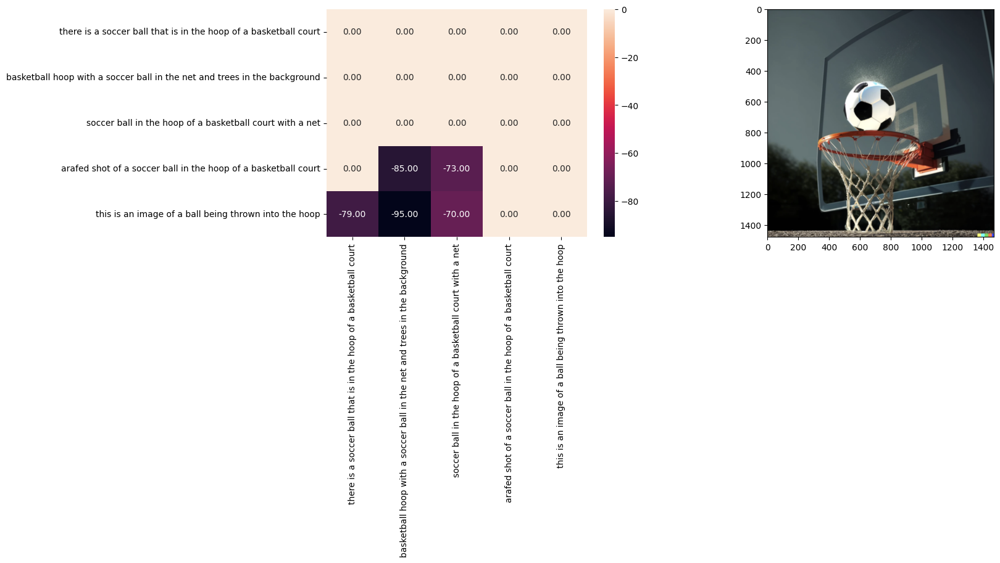

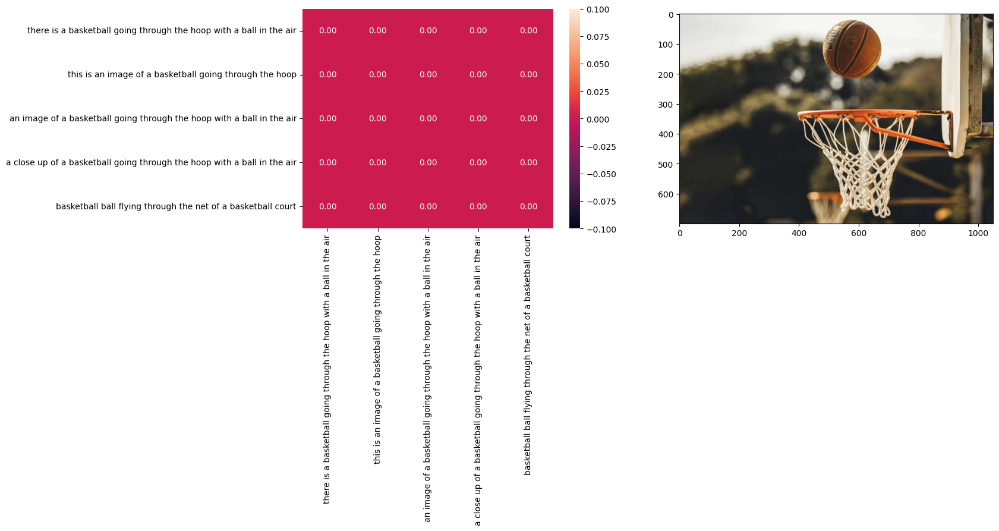

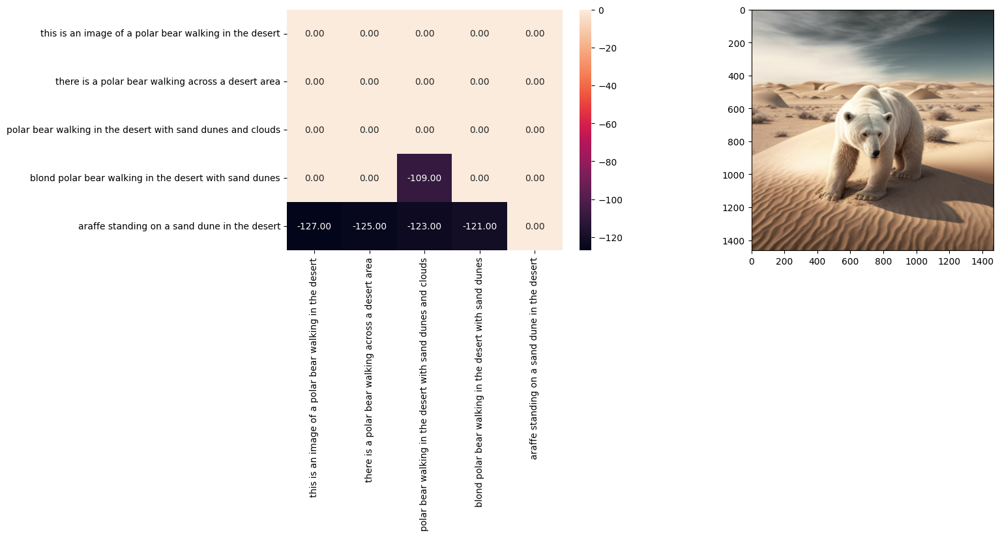

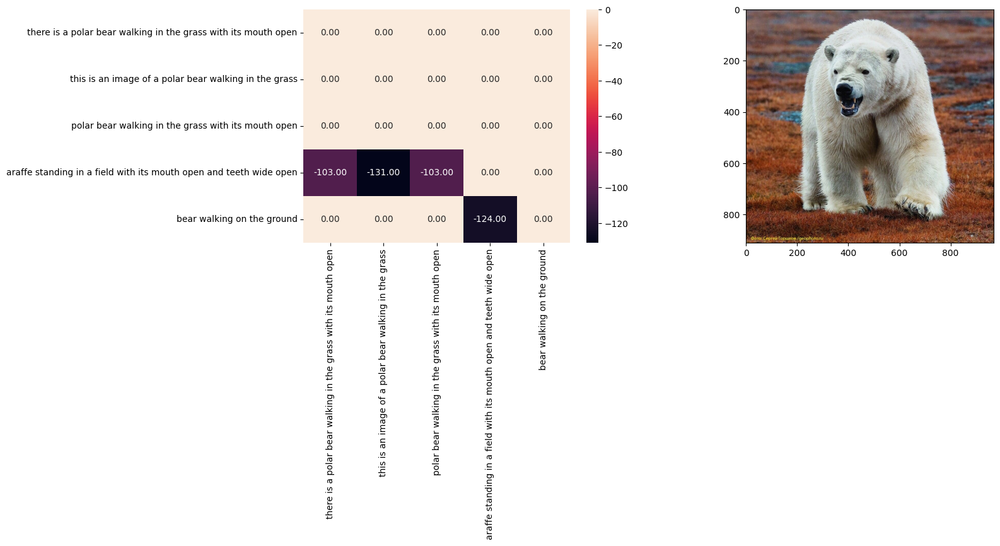

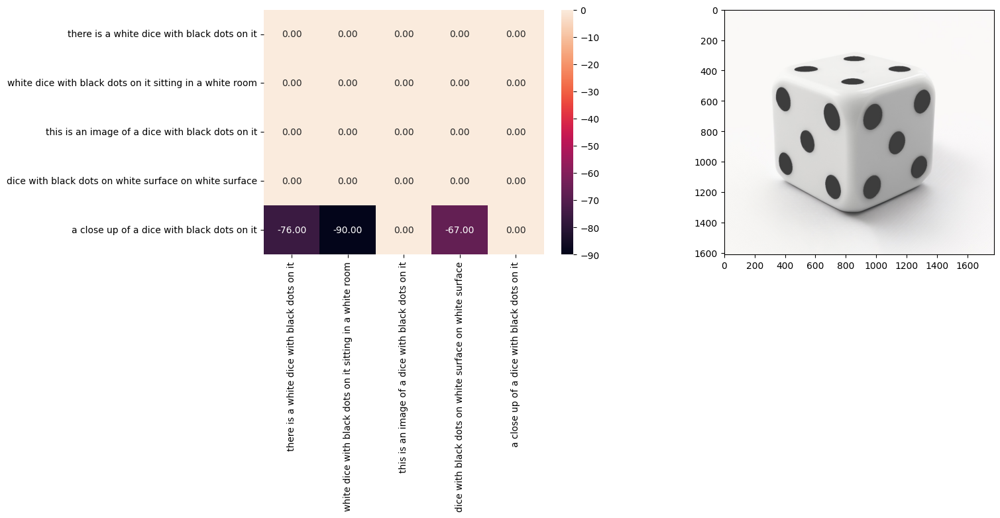

...

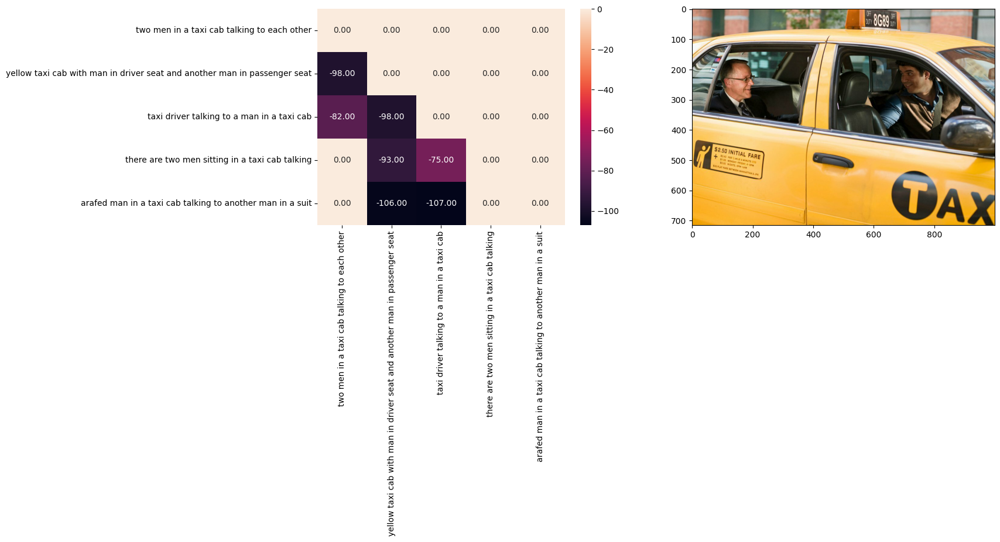

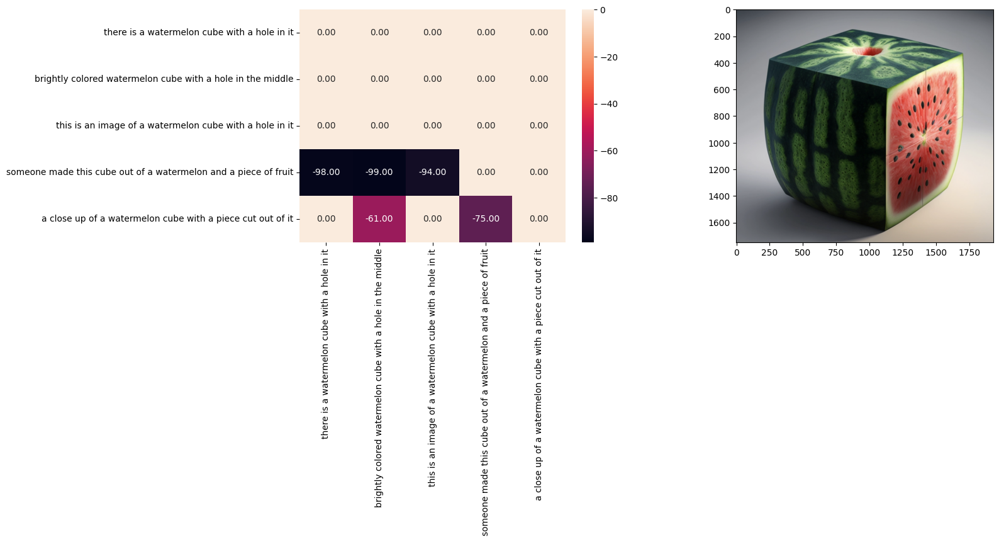

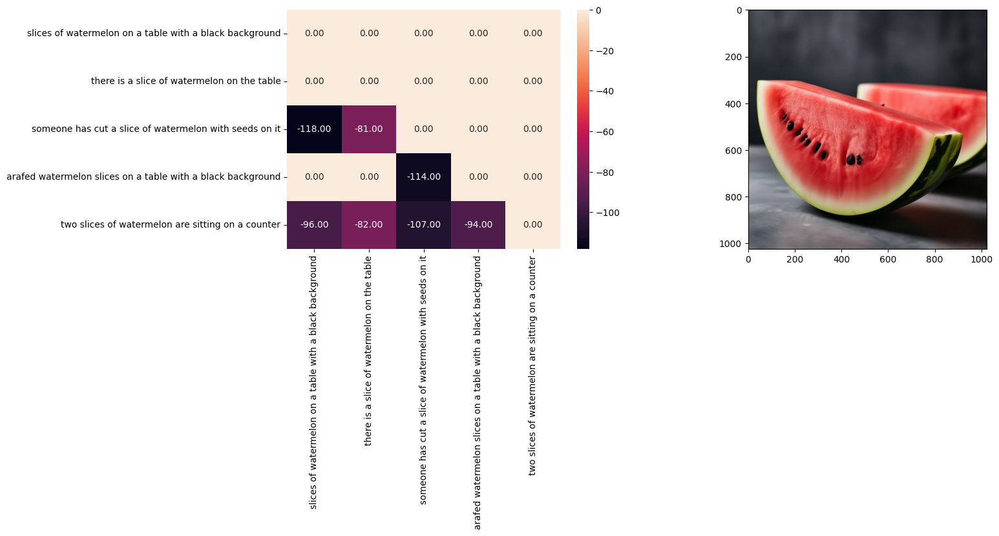

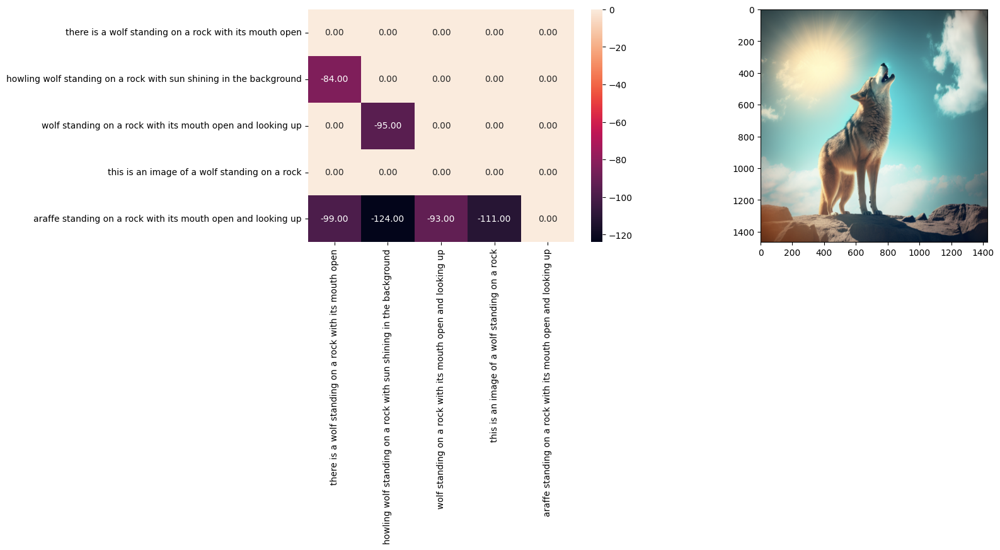

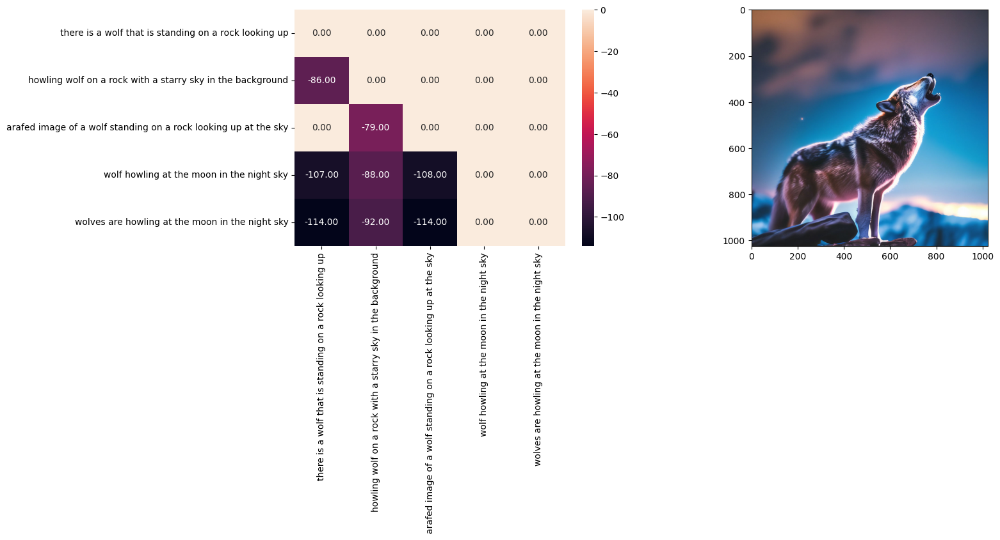

In [34]:
for i, cap_model in enumerate(['llava', 'blip', 'gpt2', 'gpt4']):
    res = {}

    vnli = json.load(open(f'outputs_{cap_model}/vq2_scores.json', 'r'))
    img_paths = sorted(vnli.keys())

    for img_path in tqdm(img_paths):
        scores = vnli[img_path]
        atomic_facts = list(scores.keys())

        classified_facts, metric, min_facts = classify_facts(atomic_facts)
        res[img_path] = metric

        if cap_model == 'blip':
            fig, axs = plt.subplots(ncols=2)
            fig.set_figwidth(15)
            img = Image.open(os.path.join('../dataset', img_path))
            imgplot = plt.imshow(img)
            sns.heatmap(classified_facts, annot=True, fmt=".2f", ax=axs[0])

    _, acc = show_results(res)
    all_res[i].append(acc)

  0%|          | 0/38 [00:00<?, ?it/s]

/home/petrushina/miniconda3/envs/llm/lib/python3.10/site-packages/transformers/generation/utils.py:1260: UserWarning: Using the model-agnostic default `max_length` (=20) to control thegeneration length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(
/home/petrushina/miniconda3/envs/llm/lib/python3.10/site-packages/transformers/generation/utils.py:1260: UserWarning: Using the model-agnostic default `max_length` (=20) to control thegeneration length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(
/home/petrushina/miniconda3/envs/llm/lib/python3.10/site-packages/transformers/generation/utils.py:1260: UserWarning: Using the model-agnostic default `max_length` (=20) to control thegeneration length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
  warnings.warn(
/home/petrushina/miniconda3/envs/llm/lib/python3.10/site-packages/transformers/

Acc = 0.631578947368421


IndexError: list index out of range

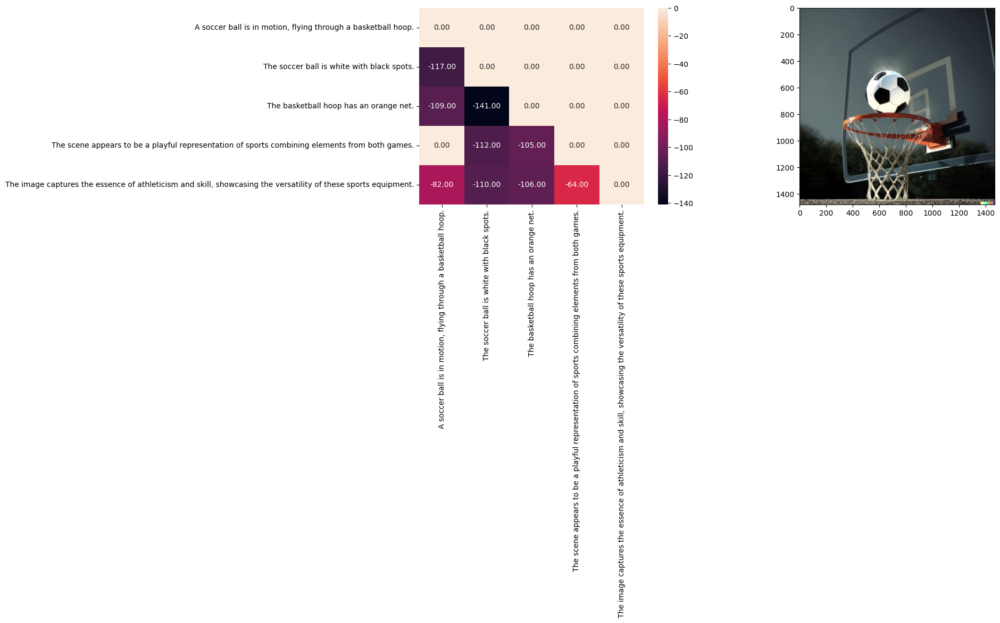

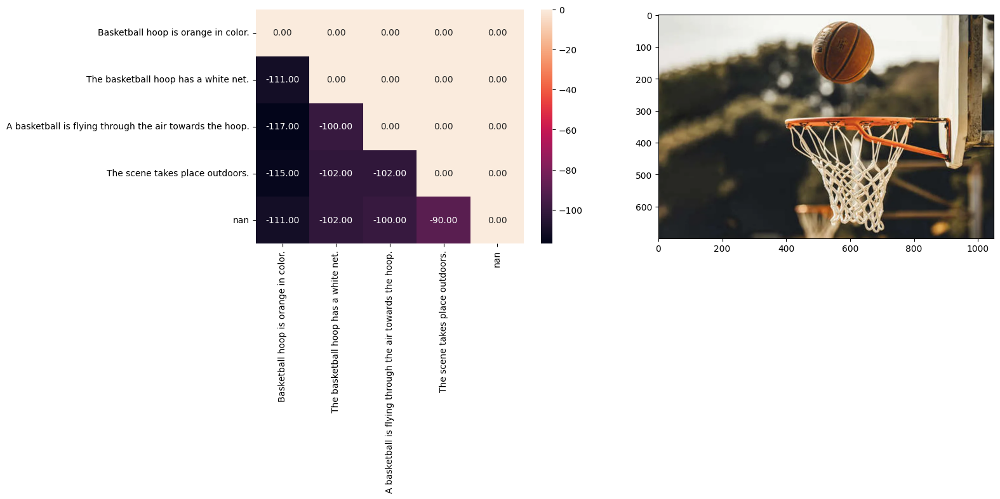

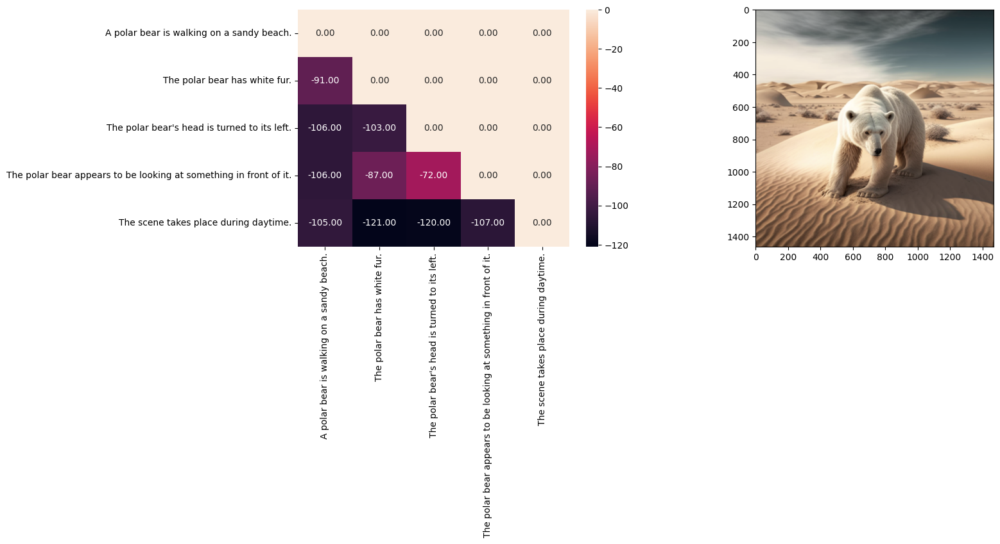

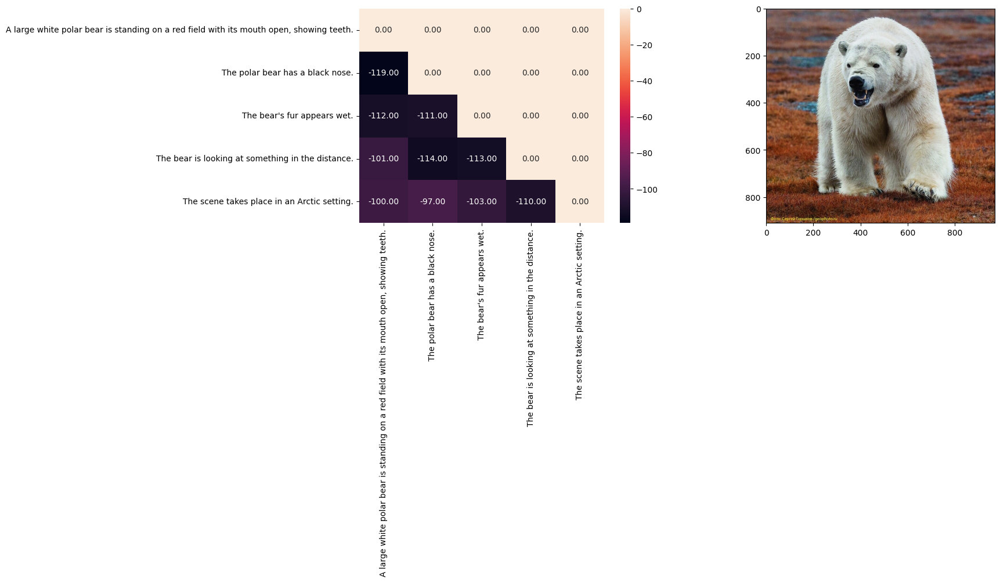

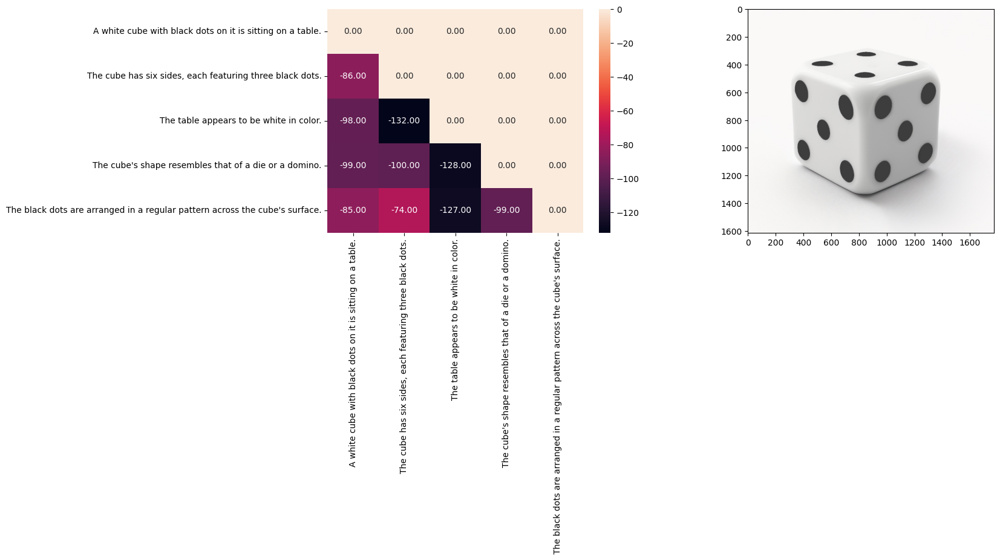

...

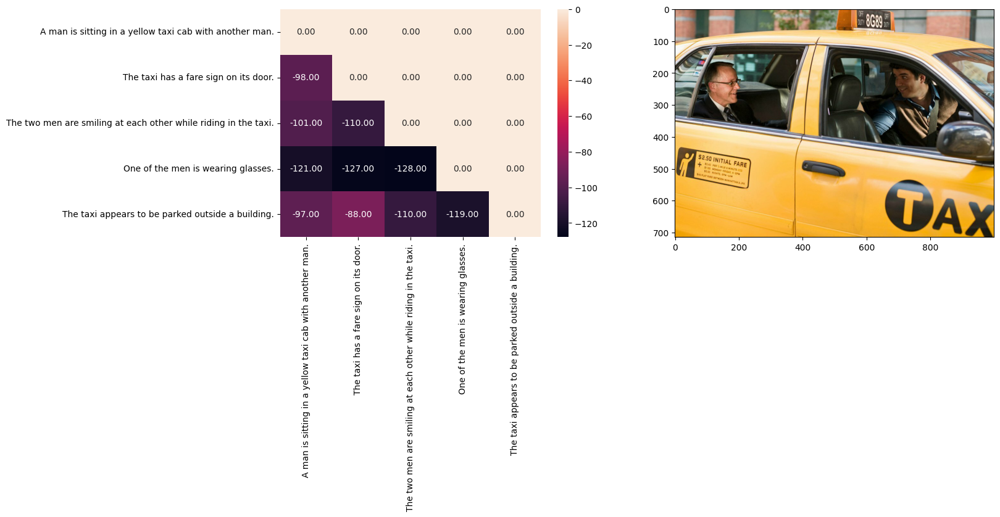

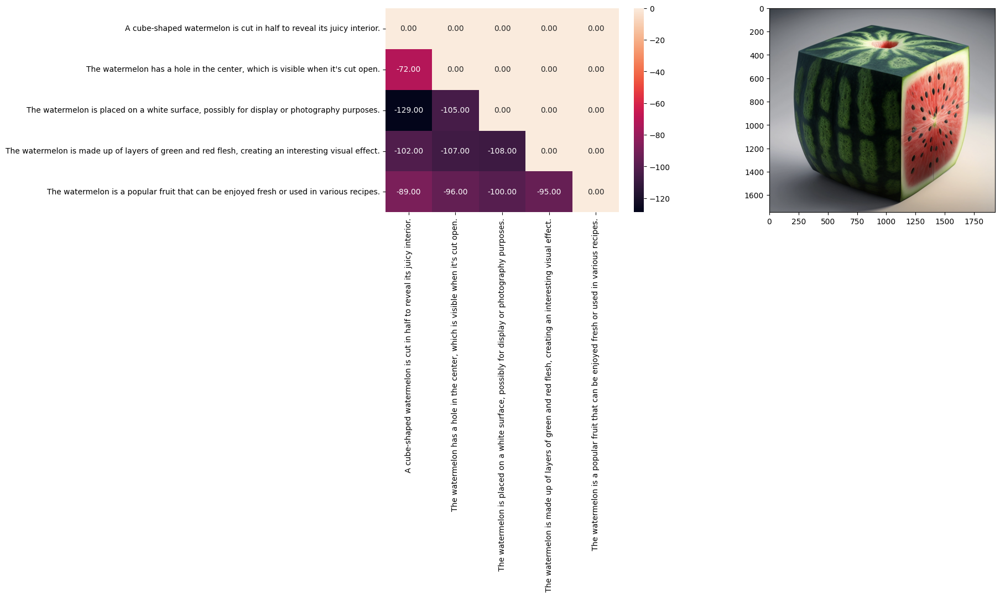

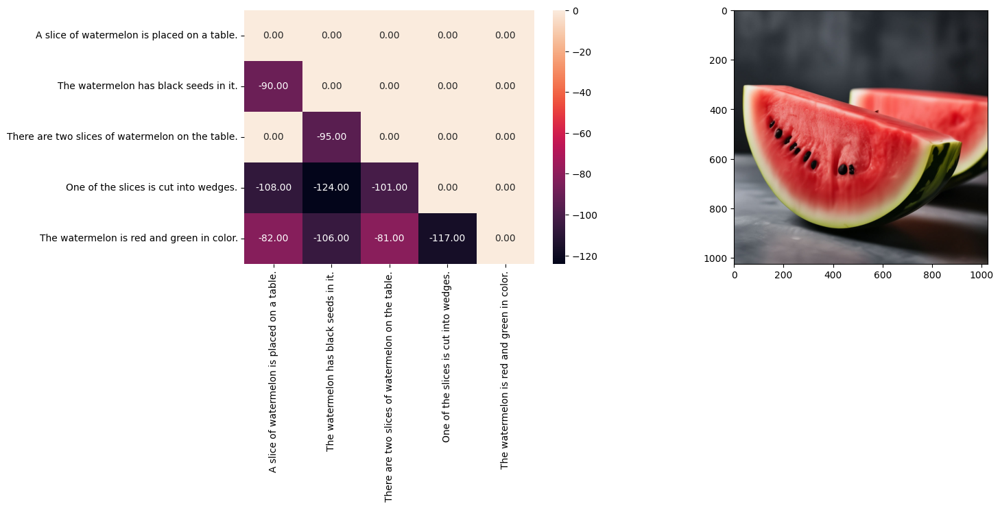

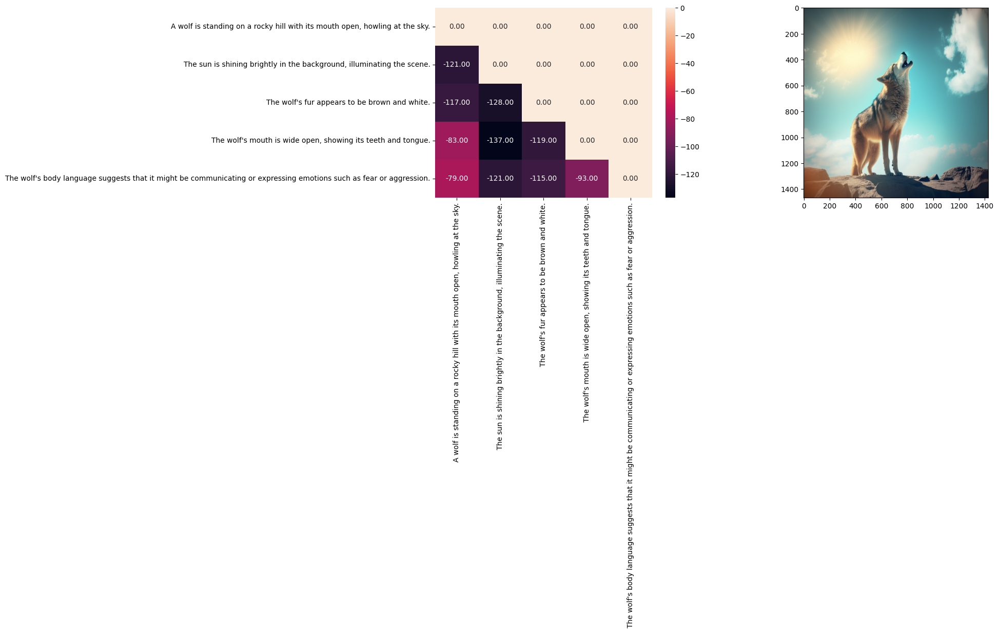

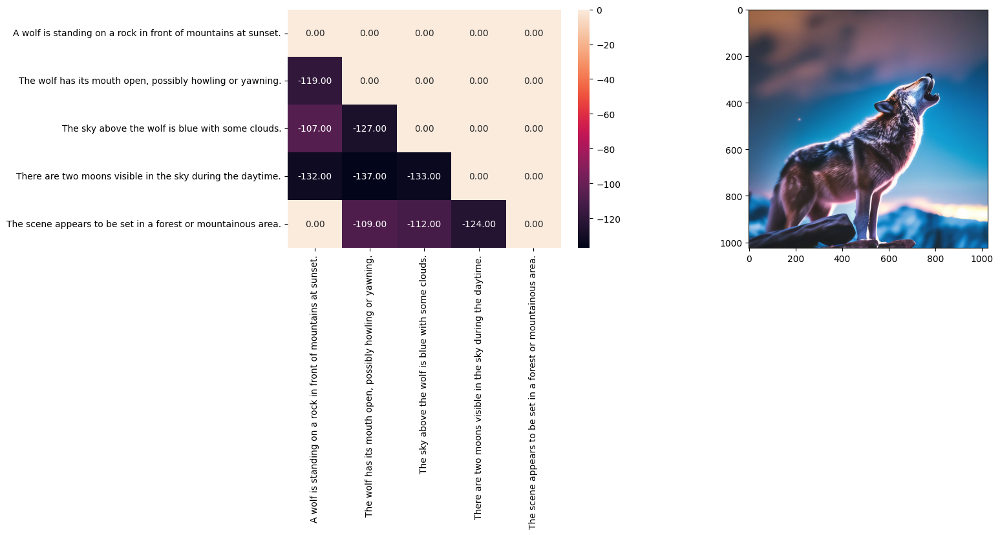

In [4]:
for i, cap_model in enumerate(['llava']):
    res = {}

    vnli = json.load(open(f'outputs_{cap_model}/vq2_scores.json', 'r'))
    img_paths = sorted(vnli.keys())

    for img_path in tqdm(img_paths):
        scores = vnli[img_path]
        atomic_facts = list(scores.keys())

        classified_facts, metric, min_facts = classify_facts(atomic_facts)
        res[img_path] = metric

        if cap_model == 'llava':
            fig, axs = plt.subplots(ncols=2)
            fig.set_figwidth(15)
            img = Image.open(os.path.join('../dataset', img_path))
            imgplot = plt.imshow(img)
            sns.heatmap(classified_facts, annot=True, fmt=".2f", ax=axs[0])

    _, acc = show_results(res)
    all_res[i].append(acc)

## Results

In [36]:
pd.DataFrame(all_res, columns=['sileod', 'MoritzLaurer', 'TrueTeacher'], index=['llava', 'blip', 'gpt2', 'gpt4'])

,sileod,MoritzLaurer,TrueTeacher
llava,0.684211,0.421053,0.631579
blip,0.526316,0.684211,0.526316
gpt2,0.368421,0.315789,0.368421
gpt4,0.631579,0.684211,0.368421
